In [2]:
from keras.layers import Input, Lambda, Dense, Flatten
from keras.models import Model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
import tensorflow as tf
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

## Displaying Images

This cell displays the first 5 images from the `normal` and `potholes` folders using the `PIL` and `IPython.display` libraries. The images are displayed using the `_Imgdis` function from `IPython.display` and are resized to 240x240 pixels. 

This cell is useful for visualizing the images in the dataset and verifying that they are being loaded correctly.


Working with 352 images
Image examples: 
63.jpg


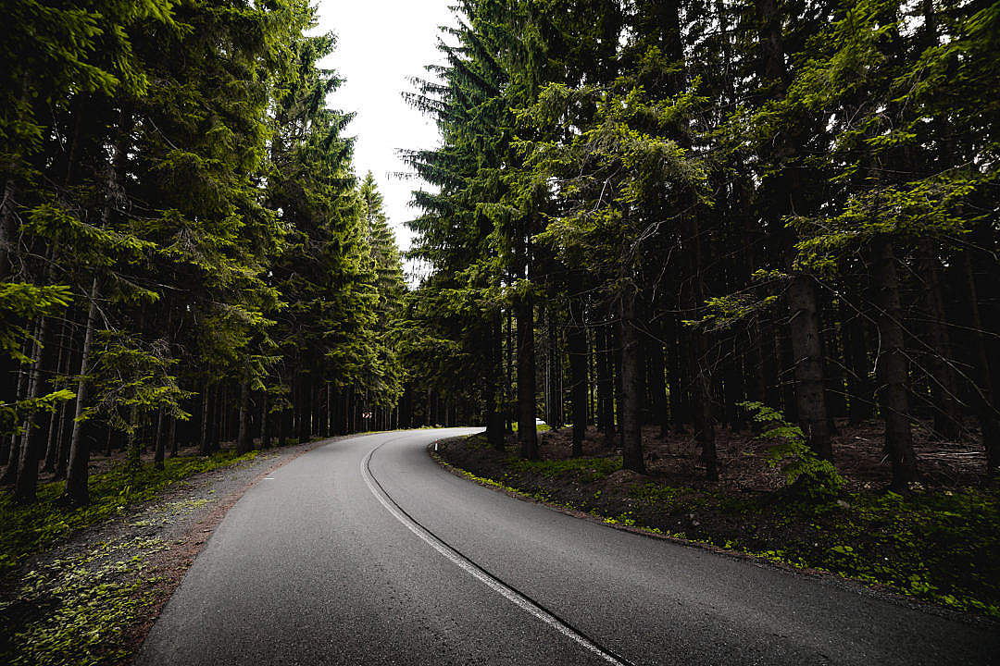

189.jpg


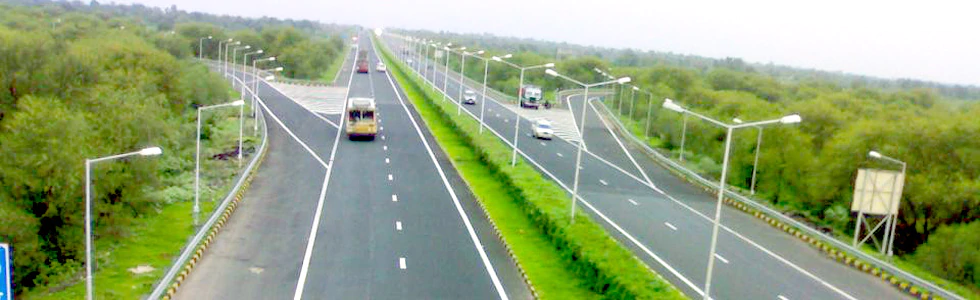

77.jpg


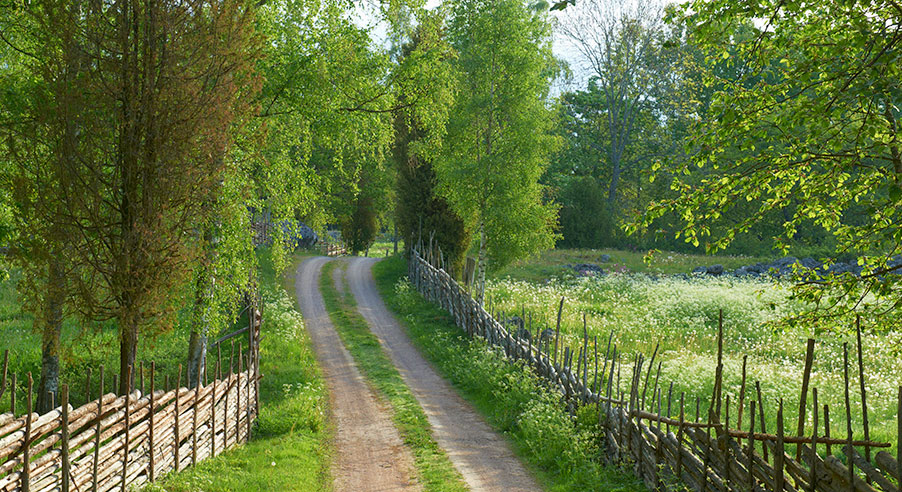

162.jpg


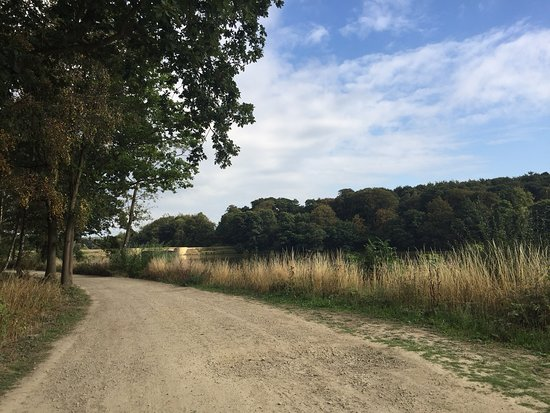

176.jpg


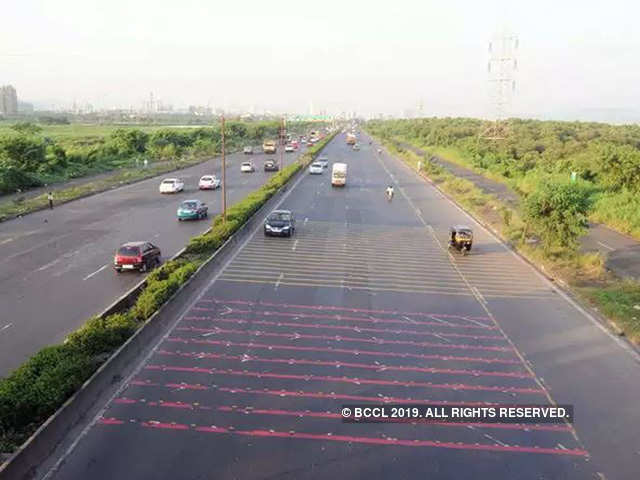

In [4]:
from PIL import Image 
import os 
from IPython.display import display
from IPython.display import Image as _Imgdis

IMAGE_SIZE = [224, 224]
train_path = '/Users/henrycooper/Developer/Comp 352/Modules/Module_5/Assigment_5.1/images/'
folder = train_path+'normal/'

only_normal_files = [f for f in os.listdir(folder) if os.path.isfile(os.path.join(folder, f))]
print("Working with {0} images".format(len(only_normal_files)))
print("Image examples: ")
for i in range(5):
    print(only_normal_files[i])
    display(_Imgdis(filename=folder + "/" + only_normal_files[i], width=240, height=240))
    

Working with 329 images
Image examples: 
63.jpg


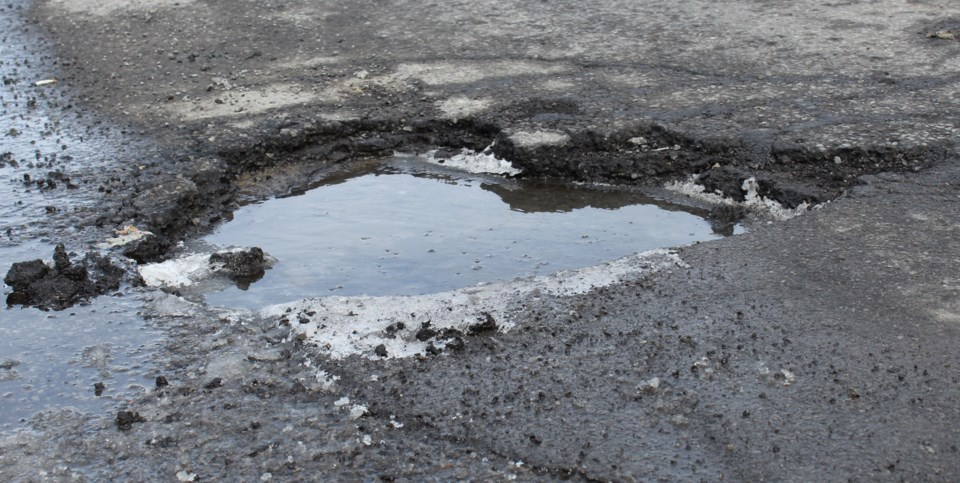

189.jpg


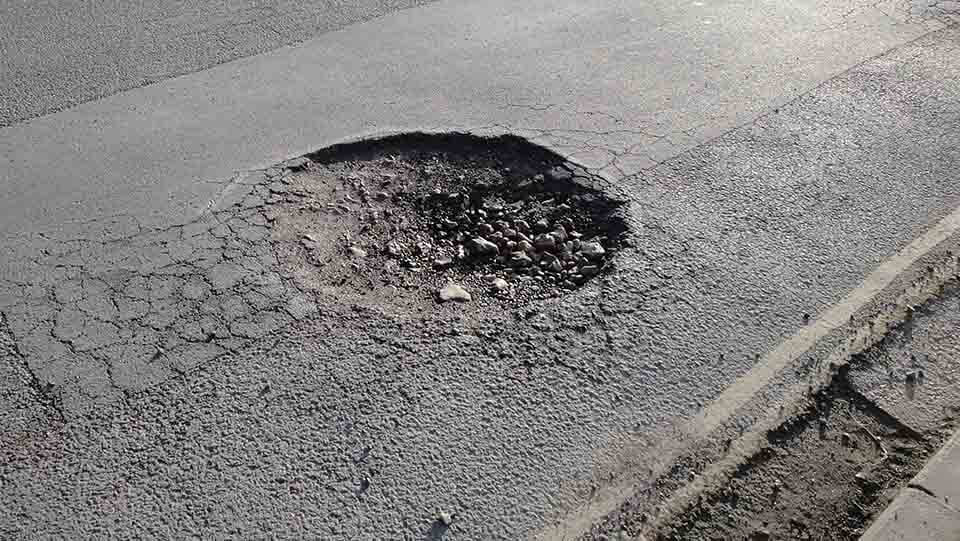

77.jpg


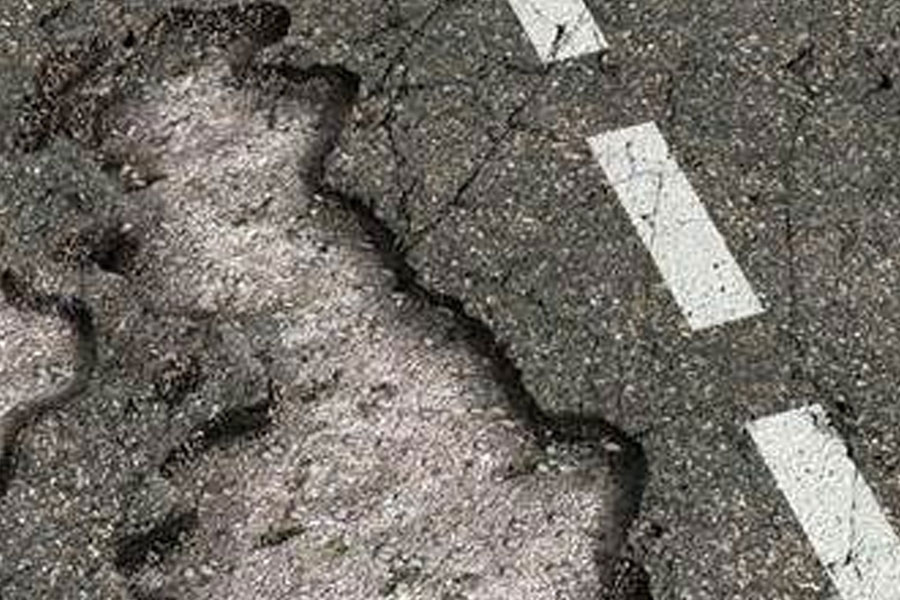

162.jpg


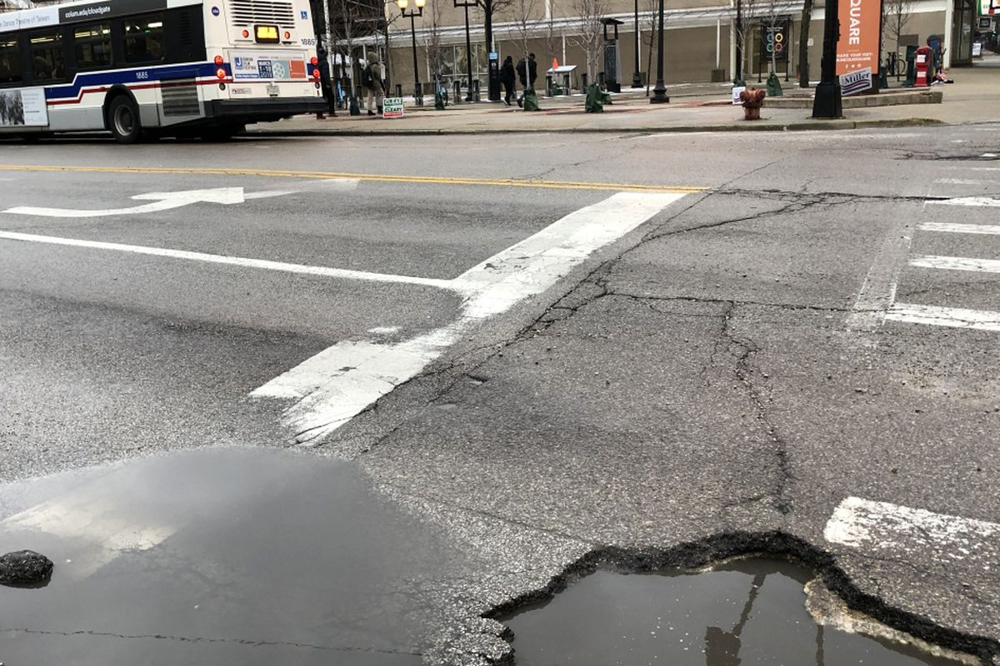

176.jpg


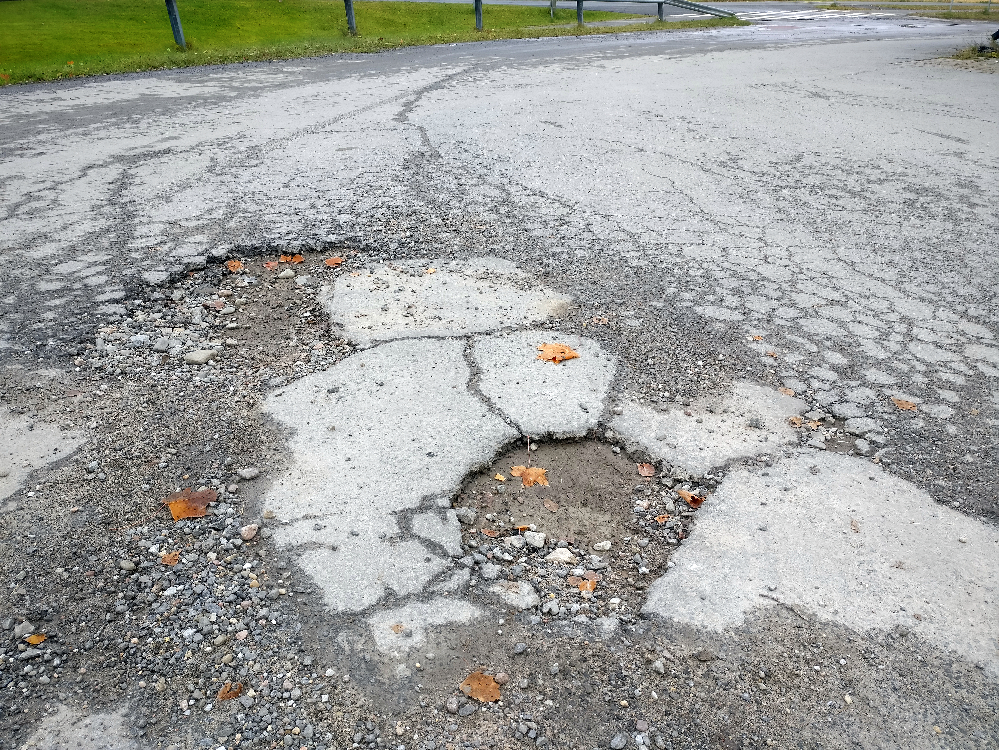

In [2]:
folder = train_path+'potholes/'

only_potholes_files = [f for f in os.listdir(folder) if os.path.isfile(os.path.join(folder, f))]
print("Working with {0} images".format(len(only_potholes_files)))
print("Image examples: ")
for i in range(5):
    print(only_potholes_files[i])
    display(_Imgdis(filename=folder + "/" + only_potholes_files[i], width=240, height=240))

### defining the model

In [16]:
from keras.layers import Input, Lambda, Dense, Flatten
from keras.models import Model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing import image
#from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
import numpy as np
from glob import glob
import matplotlib.pyplot as plt



folders = glob('D:/Projects/PotHole Detection/images/*')

vgg = VGG16(input_shape=IMAGE_SIZE + [3], weights='imagenet', include_top=False)
vgg.input
for layer in vgg.layers:
    layer.trainable = False


x = Flatten()(vgg.output) # Flatten the output layer to 1 dimension
prediction = Dense(len(folders), activation='softmax')(x)
model = Model(inputs=vgg.input, outputs=prediction)
model.summary()


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_8 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 0)              │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 14,714,688 (56.13 MB)

Found 681 images belonging to 2 classes.
Epoch 1/10
5/5 - 5s - 1s/step - accuracy: 0.4812 - loss: 287.9232
Epoch 2/10
5/5 - 2s - 455ms/step - accuracy: 0.5938 - loss: 106.2806
Epoch 3/10
5/5 - 2s - 411ms/step - accuracy: 0.7125 - loss: 36.6024
Epoch 4/10
5/5 - 1s - 175ms/step - accuracy: 0.7956 - loss: 9.7455
Epoch 5/10
5/5 - 0s - 82ms/step - accuracy: 0.8125 - loss: 5.4138
Epoch 6/10
5/5 - 5s - 971ms/step - accuracy: 0.8750 - loss: 2.6646
Epoch 7/10
5/5 - 2s - 484ms/step - accuracy: 0.8313 - loss: 2.6807
Epoch 8/10
5/5 - 2s - 425ms/step - accuracy: 0.8500 - loss: 1.6435
Epoch 9/10
5/5 - 1s - 173ms/step - accuracy: 0.8248 - loss: 1.9188
Epoch 10/10
5/5 - 0s - 84ms/step - accuracy: 0.8594 - loss: 1.0071
Training completed in time:  0:00:22.148898


2024-09-28 21:02:01.476350: I tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


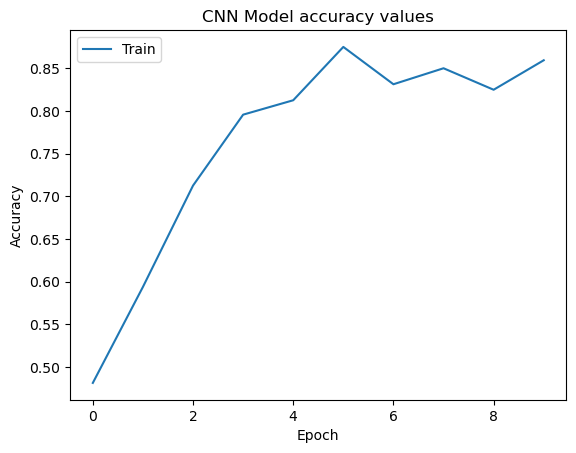

In [42]:
from tensorflow.keras import optimizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from datetime import datetime
from keras.callbacks import ModelCheckpoint

# Build the model (example CNN architecture)
model = Sequential()

# Example Conv2D layers (modify as per your use case)
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Flatten the output of the conv layers
model.add(Flatten())

# Final Dense layer for classification
model.add(Dense(2, activation='softmax'))  # Two neurons for two classes

# Compile the model
adam = optimizers.Adam()
model.compile(loss='categorical_crossentropy', optimizer=adam, metrics=['accuracy'])

# Image Data Generator
train_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

train_set = train_datagen.flow_from_directory(
    train_path,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical'  # Ensure the class_mode is 'categorical' for one-hot encoding
)

# Checkpointing to save the best model
checkpoint = ModelCheckpoint(filepath='mymodel.keras', 
                             verbose=2, save_best_only=True)

callbacks = [checkpoint]

# Start training
start = datetime.now()

model_history = model.fit(
    train_set,
    epochs=10,
    steps_per_epoch=5,
    validation_steps=32,
    callbacks=callbacks,
    verbose=2
)

duration = datetime.now() - start
print("Training completed in time: ", duration)

plt.plot(model_history.history['accuracy'])
plt.title('CNN Model accuracy values')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()


/Users/henrycooper/Developer/Comp 352/Modules/Module_5/Assigment_5.1/images/


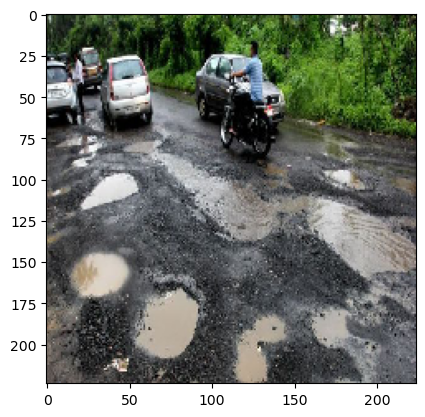

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
[[0.4665109 0.5334891]]


In [46]:
print(train_path)
test_image = image.load_img(train_path + "potholes/10.jpg", target_size = (224, 224))
plt.imshow(test_image)
plt.show()

test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
test_image = preprocess_input(test_image)
result = model.predict(test_image)
print(result)

/Users/henrycooper/Developer/Comp 352/Modules/Module_5/Assigment_5.1/images/


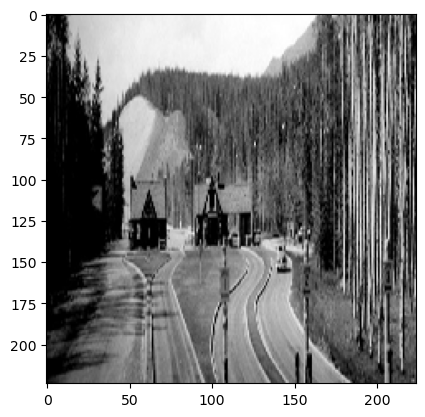

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
[[0.00120616 0.99879384]]


In [47]:
print(train_path)
test_image = image.load_img(train_path + "normal/10.jpg", target_size = (224, 224))
plt.imshow(test_image)
plt.show()

test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
test_image = preprocess_input(test_image)
result = model.predict(test_image)
print(result)